### Food-101 Challenge Problem

Name: Anas Patankar <br>
Email: anasapatankar@gmail.com

In [3]:
# importing required packages for challenge
import torch
from torch import nn
from torch import cuda
from torch import optim
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch import Tensor
from torch.optim import SGD
import torch.nn.functional as F
from torchvision import datasets, transforms, models
import numpy as np
import glob
import matplotlib.pyplot as plt
import matplotlib.image as img
from collections import Counter
import pandas as pd
from timeit import default_timer as timer
import collections
from shutil import copy
import os
from collections import defaultdict

In [3]:
#mounting drive to import dataset
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [6]:
#Unzipping food-101 dataset
!tar -xf "/content/drive/My Drive/food-101.tar.gz" 

In [7]:
print("Contents of the downloaded directory")
os.listdir('food-101')

Contents of the downloaded directory


['meta', 'images', 'README.txt', 'license_agreement.txt']

In [8]:
print("Contents of the images folder")
os.listdir('food-101/images')

Contents of the images folder


['waffles',
 'spaghetti_carbonara',
 'strawberry_shortcake',
 'guacamole',
 'omelette',
 'pancakes',
 'tuna_tartare',
 'grilled_salmon',
 'bibimbap',
 'cheese_plate',
 'nachos',
 'red_velvet_cake',
 'falafel',
 'churros',
 'chicken_curry',
 'dumplings',
 'beignets',
 'chicken_wings',
 'oysters',
 'huevos_rancheros',
 'cup_cakes',
 'chocolate_mousse',
 'fish_and_chips',
 'spaghetti_bolognese',
 'club_sandwich',
 'french_onion_soup',
 'french_toast',
 'ice_cream',
 'bruschetta',
 'caesar_salad',
 'pad_thai',
 'lasagna',
 'garlic_bread',
 'paella',
 'prime_rib',
 'pork_chop',
 'scallops',
 'gyoza',
 'ceviche',
 'filet_mignon',
 'escargots',
 'beef_tartare',
 'sushi',
 'eggs_benedict',
 'miso_soup',
 'pizza',
 'baby_back_ribs',
 'cannoli',
 'baklava',
 'shrimp_and_grits',
 'tacos',
 'bread_pudding',
 'spring_rolls',
 'macarons',
 'takoyaki',
 'donuts',
 'cheesecake',
 'fried_calamari',
 'gnocchi',
 'greek_salad',
 'ramen',
 'risotto',
 'lobster_bisque',
 'onion_rings',
 'pho',
 'creme_brul

In [ ]:
print("Contents of meta data")
os.listdir('food-101/meta')

Contents of meta data


['train.json',
 'train.txt',
 'test.json',
 'classes.txt',
 'test.txt',
 'labels.txt']

### Understanding the Data

In [ ]:
print("Total Number of Classes: ", len(os.listdir('food-101/images')))
print("\n")
#Total number of images in each category
for i in os.listdir('food-101/images'):
    print("Total {} images: {}".format(i,len(os.listdir('food-101/images/'+i))))
print("\n")
print("TOTAL IMAGES: ", len(glob.glob("food-101/images/**/*.jpg")))

Total Number of Classes:  101


Total sashimi images: 1000
Total beef_carpaccio images: 1000
Total tacos images: 1000
Total grilled_cheese_sandwich images: 1000
Total frozen_yogurt images: 1000
Total tuna_tartare images: 1000
Total miso_soup images: 1000
Total scallops images: 1000
Total peking_duck images: 1000
Total macarons images: 1000
Total bibimbap images: 1000
Total deviled_eggs images: 1000
Total lobster_bisque images: 1000
Total prime_rib images: 1000
Total falafel images: 1000
Total grilled_salmon images: 1000
Total huevos_rancheros images: 1000
Total baby_back_ribs images: 1000
Total pork_chop images: 1000
Total pizza images: 1000
Total dumplings images: 1000
Total carrot_cake images: 1000
Total club_sandwich images: 1000
Total hummus images: 1000
Total garlic_bread images: 1000
Total steak images: 1000
Total spring_rolls images: 1000
Total caprese_salad images: 1000
Total eggs_benedict images: 1000
Total gyoza images: 1000
Total pad_thai images: 1000
Total ceviche images: 1

Total Number of Categories: **101** <br>
Number of images in each category: **1000** <br>
Total Images: **10100**

### Visualizing an image in each category

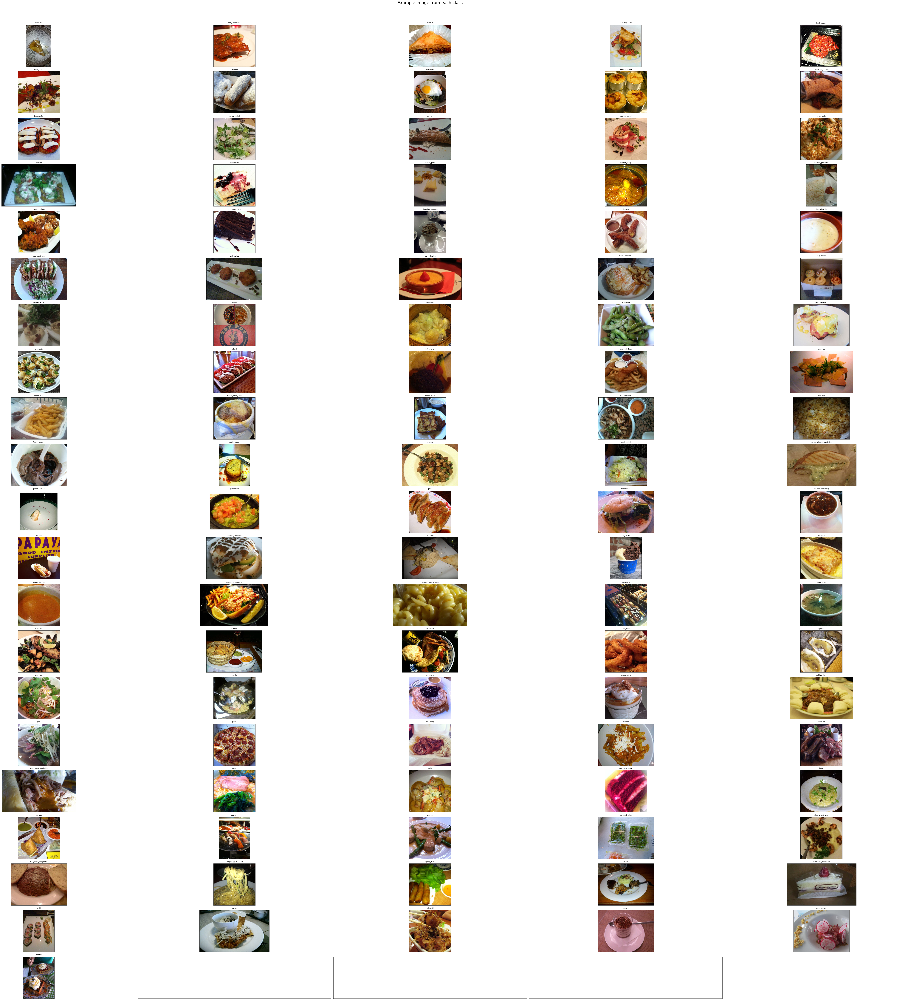

In [6]:
data_dir = 'food-101/images'
food_cat = os.listdir(data_dir)
fig, ax = plt.subplots(21,5, figsize=(100,100))
plt.axis('off')

fig.suptitle("Example image from each class",y = 1.02 ,fontsize=30) 
count = 0

for i in range(21):
    for j in range(5):
        total_img_cat_dir = os.path.join(data_dir, food_cat[count])
        first_image = os.listdir(total_img_cat_dir)[0]
        img = plt.imread(os.path.join(data_dir, food_cat[count], first_image ))
        ax[i][j].imshow(img)
        ax[i][j].set_title(food_cat[count], pad = 10)
        count+=1
        if count == len(food_cat):
            break
plt.setp(ax, xticks=[],yticks=[])
plt.tight_layout()

### Splitting into Train and Test set using the meta data

In [27]:

def split_data(filepath, src, dest):
    classes_images = defaultdict(list)
    with open(filepath, 'r') as txt:
        filepath = [read.strip() for read in txt.readlines()]
        for file in filepath:
            doc_name = file.split('/')
            cat, img = doc_name[0], doc_name[1]
            classes_images[cat].append(img + '.jpg')

    for class_ in classes_images.keys():
        if not os.path.exists(os.path.join(dest, class_)):
            os.makedirs(os.path.join(dest,class_))
        for i in classes_images[class_]:
            copy(os.path.join(src,class_,i), os.path.join(dest,class_,i))


In [28]:
print("Creating train data...")
split_data('food-101/meta/train.txt', 'food-101/images', 'food-101/train')
print("Training data folder created")

Creating train data...
Training data folder created


In [29]:
print("Creating test data...")
split_data('food-101/meta/test.txt', 'food-101/images', 'food-101/test')
print("Testing data folder created")

Creating test data...
Testing data folder created


### Defining Transforms

In [25]:
# Image transformations
image_transforms = {
    # Train uses data augmentation
    'train':
    transforms.Compose([
        transforms.RandomResizedCrop(size=256, scale=(0.8, 1.0)),
        transforms.RandomRotation(degrees=30),
        transforms.RandomAffine(30),
        transforms.ColorJitter(),
        transforms.RandomHorizontalFlip(),
        transforms.CenterCrop(size=224),  # Image net standards
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406],
                             [0.229, 0.224, 0.225])  # Imagenet standards
    ]),
    
     #Test uses data augmentation
    'test':
    transforms.Compose([
        transforms.Resize(size=256),
        transforms.TenCrop(size=224),
        transforms.Lambda(lambda crops: torch.stack([transforms.ToTensor()(crop) for crop in crops])),
        transforms.Lambda(lambda crops: torch.stack([transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225])(crop) for crop in crops])
    )])}

### Defining DataLoaders

In [214]:
traindir = 'food-101/train'
testdir = 'food-101/test'

# Datasets from folders
data = {
    'train':
    datasets.ImageFolder(root=traindir, transform=image_transforms['train']),
    'test':
    datasets.ImageFolder(root=testdir, transform=image_transforms['test'])
}

# Dataloader iterators
dataloaders = {
    'train': torch.utils.data.DataLoader(data['train'], batch_size=64, shuffle=True),
    'test': torch.utils.data.DataLoader(data['test'], batch_size=64, shuffle=True)
}

In [ ]:
print("Total number of images in the Training Set: ", len(data['train'].targets))
print("Total number of images in the Testing Set: ", len(data['test'].targets))

Total number of images in the Training Set:  75750
Total number of images in the Testing Set:  25250


In [ ]:
# Iterate through the dataloader once
trainiter = iter(dataloaders['train'])
features, labels = next(trainiter)
features.shape, labels.shape

(torch.Size([64, 3, 224, 224]), torch.Size([64]))

In [ ]:
#Train-Test distribution

train_dist = Counter(data['train'].targets)
test_dist =  Counter(data['test'].targets)
df_train = pd.DataFrame(list(train_dist.values()), index = data['train'].class_to_idx.keys(), columns = ['Training Set'])
df_test = pd.DataFrame(list(test_dist.values()), index = data['test'].class_to_idx.keys(), columns = ['Testing Set'])
pd.merge(df_train, df_test,left_index = True, right_index=True)

,Training Set,Testing Set
apple_pie,750,250
baby_back_ribs,750,250
baklava,750,250
beef_carpaccio,750,250
beef_tartare,750,250
...,...,...
tacos,750,250
takoyaki,750,250
tiramisu,750,250
tuna_tartare,750,250


### Training the Model

In [ ]:
# Load the ResNet-50 model pretraned on ImageNet 
model = models.resnet50(pretrained=True)

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/checkpoints/resnet50-19c8e357.pth


In [ ]:
# Freezing the initial layers
for param in model.parameters():
    param.requires_grad=False

In [ ]:
#number of features going into the fully connected layer
n_inputs = model.fc.in_features

#number of class labels
n_classes = 101

#modifying the fully connected layers by attaching layers sequentially
model.fc = nn.Sequential(
                      nn.Linear(n_inputs, 256), 
                      nn.ReLU(), 
                      nn.Dropout(0.4),
                      nn.Linear(256, n_classes))

In [ ]:
total_params = sum(p.numel() for p in model.parameters())
print(f'{total_params:,} total parameters.')

total_trainable_params = sum(
    p.numel() for p in model.parameters() if p.requires_grad == True)
print(f'{total_trainable_params:,} training parameters.')

24,058,533 total parameters.
550,501 training parameters.


In [ ]:
# Whether to train on a gpu
train_on_gpu = cuda.is_available()
multi_gpu = False
print(f'Train on gpu: {train_on_gpu}')

# Number of gpus
if train_on_gpu:
    
    gpu_count = cuda.device_count()
    
    print(f'{gpu_count} gpu detected.')
    if gpu_count > 1:
        multi_gpu = True
    else:
        multi_gpu = False
        
if train_on_gpu:
    model = model.to('cuda')
if multi_gpu:
    model = nn.DataParallel(model)

Train on gpu: True
1 gpu detected.


In [ ]:
# specify loss function 
criterion = nn.CrossEntropyLoss()

# specifying optimizer
optimizer = optim.SGD(model.fc.parameters(), lr=0.01, momentum=0.9)

# secifying scheduler 
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience = 5)

In [ ]:
def train(model,
          criterion,
          optimizer,
          train_loader,
          valid_loader,
          save_file_name,
          max_no_improvement_epoch=10,
          n_epochs=20,
          start_epoch =1,
          print_every=1):

    '''
    The function runs the model through specified epochs
    and returns the trained model.

    Parameters:
    model: Intialized pre-trained Resnet50 Model
    criterion: Loss function
    optimizer: Optimizer used for backpropogation
    train and test loaders: providing mini-batch inputs
    save_file_name: File name to be used to save the model
    max_no_improvement_epoch: Number of epochs after which model should stop running if there is no decrease in loss (Early Stopping)
    n_epochs: Number of epochs for training
    start_epoch: starting epoch number
    print_every: Number of epochs after which results should be printed

    Output:
    Trained ResNet50 model on the food-101 dataSET

    '''

    if train_on_gpu:
        model.cuda()

    overall_start = timer()

    # Early stopping intialization
    model_no_improvement = 0

    valid_loss_min = np.Inf

    valid_max_acc = 0

    for epoch in range(start_epoch,n_epochs+1):


        # keep track of training and validation loss
        train_loss = 0.0
        train_accuracy = 0.0
        valid_loss = 0.0
        val_accuracy = 0.0

        #for saving the model loss and accuracy
        history = []        

        # Set to training
        model.train()
        start = timer()
      
        for i, (inputs, target) in enumerate(train_loader):

            # Tensors to gpu
            if train_on_gpu:
                inputs, target = inputs.cuda(), target.cuda()
            

            # Clear gradients
            optimizer.zero_grad()

            # Predicted outputs are log probabilities
            output = model(inputs)
            
            # Loss and backpropagation of gradients
            loss = criterion(output, target)
            loss.backward()

            # Update the parameters
            optimizer.step()

            # Track train loss by multiplying average loss by number of examples in batch
            train_loss += loss.item() * inputs.size(0)
            

            # Calculate accuracy by finding max probability
            check, pred = torch.max(output, dim=1)
            correct_tensor = pred.eq(target.data.view_as(pred))

            # Need to convert correct tensor from int to float to average
            accuracy = torch.mean(correct_tensor.type(torch.FloatTensor))

            # Multiply average accuracy times the number of examples in batch
            train_accuracy += accuracy.item() * inputs.size(0)
            
            # Track training progress
            print(f'\rEpoch: {epoch}\t{100 * (i + 1)/ len(train_loader):.2f}% complete. {timer() - start:.2f} seconds elapsed in epoch.', end = '')
      
        # After training loops ends, start validation
        with torch.no_grad():

            model.eval()

            for j, (inputs, target) in enumerate(valid_loader):

                if train_on_gpu:
                    inputs, target = inputs.cuda(), target.cuda()

                input_var = torch.autograd.Variable(inputs)
                target_var = torch.autograd.Variable(target)
                
                # compute output for 10 crop TTA
                bs, ncrops, c, h, w = input_var.size()
                temp_output = model(input_var.view(-1, c, h, w))
                output = temp_output.view(bs, ncrops, -1).mean(1)

                #track validation loss
                loss = criterion(output, target_var)
                valid_loss += loss.item()*inputs.size(0)

                #checking validation outputs
                check,pred = torch.max(output,dim = 1)
                correct_tensor = pred.eq(target.data.view_as(pred))

                # Need to convert correct tensor from int to float to average
                accuracy = torch.mean(correct_tensor.type(torch.FloatTensor))

                # Multiply average accuracy times the number of examples in batch
                val_accuracy += accuracy.item() * inputs.size(0)


            # Calculate average losses
            train_loss = train_loss / len(train_loader.dataset)
            valid_loss = valid_loss / len(valid_loader.dataset)

            # Calculate average accuracy
            train_acc = train_accuracy / len(train_loader.dataset)
            valid_acc = val_accuracy / len(valid_loader.dataset)

            #Changing learning rate based on valid loss
            scheduler.step(valid_loss)
            
            history.append([train_loss, valid_loss, train_acc, valid_acc])

            history = pd.DataFrame(history,columns=['train_loss', 'valid_loss', 'train_acc','valid_acc'])
            history.to_csv("epoch_results/epoch_results_{epoch}.csv".format(epoch=epoch))


            if epoch % print_every == 0:
                print(f'\nEpoch: {epoch} \tTraining Loss: {train_loss:.4f} \tValidation Loss: {valid_loss:.4f}')
                print(f'\t\tTraining Accuracy: {100 * train_acc:.2f}%\t Validation Accuracy: {100 * valid_acc:.2f}%')

        if valid_loss <= valid_loss_min:
            print(f'Decrease in validation loss at Epoch {epoch}, Saving Model...')
            
            #The parameters of the model to be saved
            checkpoint = {"model": model,
                  "criterion": criterion,
                  "epochs": epoch,
                  "optimizer_state": optimizer.state_dict(),
                  "model_state": model.state_dict(),
                  "valid_loss_min": valid_loss}

            # save model in colab
            torch.save(checkpoint, save_file_name)
            valid_loss_min = valid_loss
            best_epoch = epoch
        else:
            model_no_improvement+=1
            if model_no_improvement>=max_no_improvement_epoch:
                print(f'\nEarly Stopping! Total epochs: {epoch}. Best epoch: {best_epoch} with loss: {valid_loss_min:.2f} and acc: {100 * valid_acc:.2f}%')
                
                # Load the best state dict
                best_model = torch.load(save_file_name)
                model.load_state_dict(best_model['model_state'])
                
                # Attach the optimizer
                model.optimizer = optimizer

                return model
        
        
    # Attach the optimizer
    model.optimizer = optimizer
    
    # Record overall time and print out stats
    total_time = timer() - overall_start
    print(
        f'\nBest epoch: {best_epoch} with loss: {valid_loss_min:.2f} and acc: {100 * valid_acc:.2f}%'
    )
    
    return model
    
        

In [ ]:
#Start training the model
model_ = train(model,
      criterion,
      optimizer,
      train_loader=dataloaders['train'],
      valid_loader=dataloaders['test'],
      save_file_name ='res50_model_checkpoint.pth',
      max_no_improvement_epoch=10,
      n_epochs=30,
      start_epoch=1,  
      print_every=1)

Epoch: 1	100.00% complete. 625.72 seconds elapsed in epoch.
Epoch: 1 	Training Loss: 2.7560 	Validation Loss: 2.1306
		Training Accuracy: 32.53%	 Validation Accuracy: 46.37%
Decrease in validation loss at Epoch 1, Saving Model...
Epoch: 2	100.00% complete. 625.16 seconds elapsed in epoch.
Epoch: 2 	Training Loss: 2.6546 	Validation Loss: 2.0956
		Training Accuracy: 34.61%	 Validation Accuracy: 46.34%
Decrease in validation loss at Epoch 2, Saving Model...
Epoch: 3	100.00% complete. 625.58 seconds elapsed in epoch.
Epoch: 3 	Training Loss: 2.5952 	Validation Loss: 2.0195
		Training Accuracy: 36.09%	 Validation Accuracy: 49.10%
Decrease in validation loss at Epoch 3, Saving Model...
Epoch: 4	100.00% complete. 631.00 seconds elapsed in epoch.
Epoch: 4 	Training Loss: 2.5576 	Validation Loss: 1.9532
		Training Accuracy: 37.03%	 Validation Accuracy: 50.87%
Decrease in validation loss at Epoch 4, Saving Model...
Epoch: 5	100.00% complete. 625.62 seconds elapsed in epoch.
Epoch: 5 	Training L

In [ ]:
#There is no substantial decrease in loss. The model stopped training at epoch 20
#Further enhancing the accuarcy by training the entire model

# Load the saved model from last checkpoint
model_checkpoint = torch.load("res50_model_checkpoint.pth")

#Model is not pre-trained
model = models.resnet50(pretrained=False)

n_inputs = model.fc.in_features
n_classes = 101

model.fc = nn.Sequential(
                      nn.Linear(n_inputs, 256), 
                      nn.ReLU(), 
                      nn.Dropout(0.4),
                      nn.Linear(256, n_classes))

model.load_state_dict(model_checkpoint['model_state'], strict=False)

# specify loss function (categorical cross-entropy) same as used earlier
criterion = nn.CrossEntropyLoss()

# specify optimizer same as used earlier
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.9)

# secify scheduler same as used earlier
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience = 5)

In [ ]:
total_params = sum(p.numel() for p in model.parameters())
print(f'{total_params:,} total parameters.')

total_trainable_params = sum(
    p.numel() for p in model.parameters() if p.requires_grad == True)
print(f'{total_trainable_params:,} training parameters.')

24,058,533 total parameters.
24,058,533 training parameters.


In [ ]:
#Continuing training from epoch 21
model_ = train(model,
      criterion,
      optimizer,
      train_loader=dataloaders['train'],
      valid_loader=dataloaders['test'],
      save_file_name ='res50_model_checkpoint.pth',
      max_no_improvement_epoch=10,
      n_epochs=40,
      start_epoch=21,  
      print_every=1)


Epoch: 21	100.00% complete. 1018.69 seconds elapsed in epoch.
Epoch: 21 	Training Loss: 2.2804 	Validation Loss: 1.7418
		Training Accuracy: 43.49%	 Validation Accuracy: 56.18%
Decrease in validation loss at Epoch 21, Saving Model...
Epoch: 22	100.00% complete. 1002.38 seconds elapsed in epoch.
Epoch: 22 	Training Loss: 1.7478 	Validation Loss: 1.2121
		Training Accuracy: 55.51%	 Validation Accuracy: 68.14%
Decrease in validation loss at Epoch 22, Saving Model...
Epoch: 23	100.00% complete. 979.37 seconds elapsed in epoch.
Epoch: 23 	Training Loss: 1.5518 	Validation Loss: 1.0779
		Training Accuracy: 60.24%	 Validation Accuracy: 71.23%
Decrease in validation loss at Epoch 23, Saving Model...
Epoch: 24	100.00% complete. 958.09 seconds elapsed in epoch.
Epoch: 24 	Training Loss: 1.4255 	Validation Loss: 1.0725
		Training Accuracy: 63.27%	 Validation Accuracy: 71.47%
Decrease in validation loss at Epoch 24, Saving Model...
Epoch: 25	100.00% complete. 951.69 seconds elapsed in epoch.
Epoch

In [ ]:
#Further training for 10 more epochs
model_ = train(model,
      criterion,
      optimizer,
      train_loader=dataloaders['train'],
      valid_loader=dataloaders['test'],
      save_file_name ='res50_model_checkpoint.pth',
      max_no_improvement_epoch=10,
      n_epochs=50,
      start_epoch=41,  
      print_every=1)

Epoch: 41	100.00% complete. 907.48 seconds elapsed in epoch.
Epoch: 41 	Training Loss: 0.6155 	Validation Loss: 0.6988
		Training Accuracy: 83.11%	 Validation Accuracy: 81.45%
Decrease in validation loss at Epoch 41, Saving Model...
Epoch: 42	100.00% complete. 909.09 seconds elapsed in epoch.
Epoch: 42 	Training Loss: 0.6018 	Validation Loss: 0.6898
		Training Accuracy: 83.74%	 Validation Accuracy: 81.89%
Decrease in validation loss at Epoch 42, Saving Model...
Epoch: 43	100.00% complete. 958.10 seconds elapsed in epoch.
Epoch: 43 	Training Loss: 0.3785 	Validation Loss: 0.5516
		Training Accuracy: 89.45%	 Validation Accuracy: 86.04%
Decrease in validation loss at Epoch 43, Saving Model...
Epoch: 44	100.00% complete. 957.04 seconds elapsed in epoch.
Epoch: 44 	Training Loss: 0.3110 	Validation Loss: 0.5569
		Training Accuracy: 91.06%	 Validation Accuracy: 86.23%
Epoch: 45	100.00% complete. 965.82 seconds elapsed in epoch.
Epoch: 45 	Training Loss: 0.2849 	Validation Loss: 0.5650
		Trai

There is no substantial decrease in validation loss hence concluding training

### Result Plots

In [15]:
result = pd.DataFrame()
epoch_res = (glob.glob('epoch_results/*.csv'))
epoch_res = sorted(epoch_res, key = lambda x: int(x.split("_")[3].split(".")[0]))
for i in range(len(epoch_res)):
    df = pd.read_csv(epoch_res[i], index_col = 0)
    result = pd.concat([result,df])
result.reset_index(inplace = True, drop = True)

Text(0.5, 1.0, 'Training and Validation Losses')

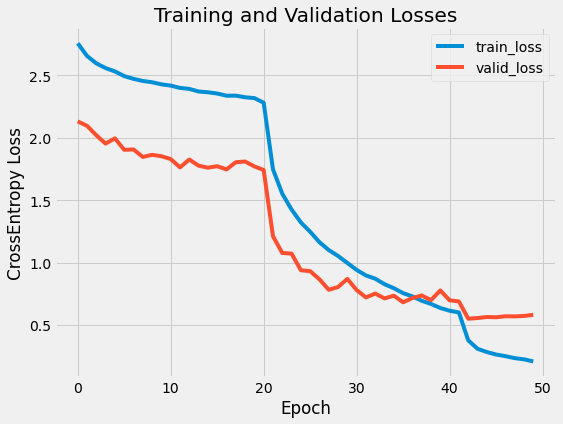

In [17]:
plt.style.use('fivethirtyeight')
plt.figure(figsize=(8, 6))
for c in ['train_loss', 'valid_loss']:
    plt.plot(
        result[c], label=c)
plt.legend()
plt.xlabel('Epoch')
plt.ylabel('CrossEntropy Loss')
plt.title('Training and Validation Losses')

Text(0.5, 1.0, 'Training and Validation Accuracy')

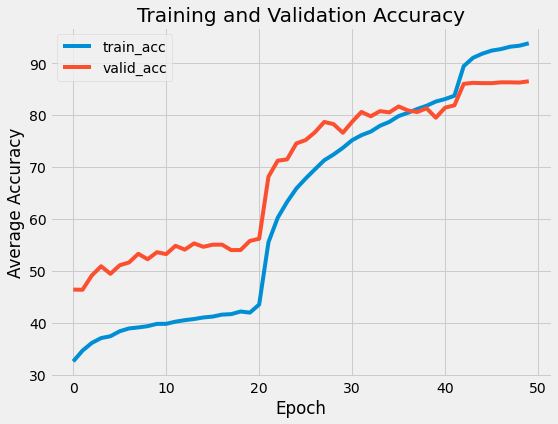

In [18]:
plt.figure(figsize=(8, 6))
for c in ['train_acc', 'valid_acc']:
    plt.plot(
        100 * result[c], label=c)
plt.legend()
plt.xlabel('Epoch')
plt.ylabel('Average Accuracy')
plt.title('Training and Validation Accuracy')

In [212]:
#Loaded the best model 
model = models.resnet50(pretrained=False)
n_inputs = model.fc.in_features
n_classes = 101

model.fc = nn.Sequential(
                      nn.Linear(n_inputs, 256), 
                      nn.ReLU(), 
                      nn.Dropout(0.4),
                      nn.Linear(256, n_classes))

best_model = torch.load('res50_model_checkpoint.pth')
model.load_state_dict(best_model['model_state'], strict = True)

<All keys matched successfully>

Calculating Overall Test Accuracy

In [216]:
#move model to gpu
train_on_gpu = True
model.cuda()
model.eval()

correct_images = 0

# iterate over test data
with torch.no_grad():
    for data, target in dataloaders['test']:
        # move tensors to GPU if CUDA is available
        if train_on_gpu:
            data, target = data.cuda(), target.cuda()
            
        # For 10-crop Testing
        bs, ncrops, c, h, w = data.size()

        # forward pass: compute predicted outputs by passing inputs to the model
        temp_output = model(data.view(-1, c, h, w))
        
        output = temp_output.view(bs, ncrops, -1).mean(1)
        
        _, pred = torch.max(output, 1)    
        # compare predictions to true label
        correct_tensor = pred.eq(target.data.view_as(pred))
      
        correct_images += np.sum(np.squeeze(correct_tensor.cpu().numpy()))


In [228]:
print(f"Final Test Accuracy: {round(correct_images/len(dataloaders['test'])*100,2)}%")

Final Test Accuracy: 86.04%


In [194]:
#Displaying an example output from each category 
def display_image(model, image_path, train_on_gpu = True):
    """
    Function takes an image from the test set and dispalys
    the image along with its respective predictions

    Parameters
    model: trained model
    image_path: path of the image for which output is to be predicted
    train_on_gpu: Computed on gpu or cpu
    
    """
    #Opening an image
    image = Image.open(image_path)

    # Resize
    img = image.resize((256, 256))

    # Center crop
    width = 256
    height = 256
    new_width = 224
    new_height = 224

    left = (width - new_width) / 2
    top = (height - new_height) / 2
    right = (width + new_width) / 2
    bottom = (height + new_height) / 2
    img = img.crop((left, top, right, bottom))

    # Convert to numpy, transpose color dimension and normalize
    img = np.array(img).transpose((2, 0, 1)) / 256

    # Standardization
    means = np.array([0.485, 0.456, 0.406]).reshape((3, 1, 1))
    stds = np.array([0.229, 0.224, 0.225]).reshape((3, 1, 1))

    img = img - means
    img = img / stds

    #Converting to tensor
    img_tensor = torch.Tensor(img)

    #Extracting real calss from name
    real_class = image_path.split('/')[-2]

    # Resize
    if train_on_gpu:
        img_tensor = img_tensor.view(1, 3, 224, 224).cuda()
    else:
        img_tensor = img_tensor.view(1, 3, 224, 224)

    # Set to evaluation
    with torch.no_grad():

        model.eval()
        model.cuda()

        # Model outputs 
        out = model(img_tensor)
        ps = F.softmax(out, dim = 1)
        topk, topclass = ps.topk(dim=1, k = 3)

        # Extract the actual classes and probabilities
        idx_class = {}
        for i,j in data['test'].class_to_idx.items():
            idx_class[data['test'].class_to_idx[i]] = i
    
        #Converting indec to class name
        top_classes = [
            idx_class[class_] for class_ in topclass.cpu().numpy()[0]
        ]
        
        top_p = topk.cpu().numpy()[0]

    plt.figure(figsize = (10,5))
    ax = plt.subplot(1,2,1)
    ax.set_title(real_class)
    plt.axis('off')
    ax.imshow(image)

    ax = plt.subplot(1,2,2)
    ax.barh(top_classes, top_p)
    ax.set_xlim(0,1)
    plt.xlabel('Predicted Probability')
    plt.tight_layout()
    plt.show()

  
    return top_p, top_classes, real_class

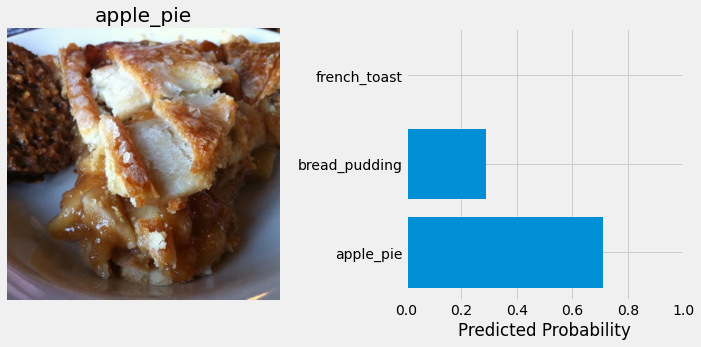

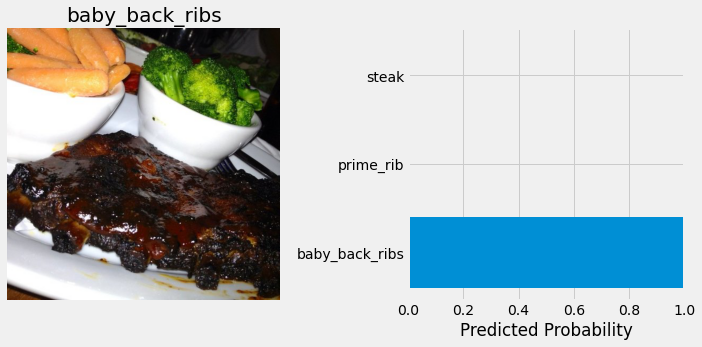

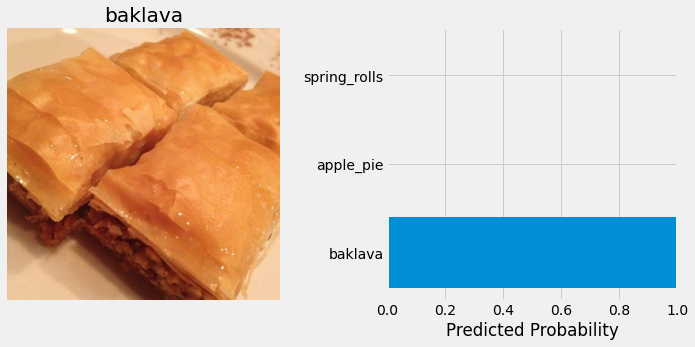

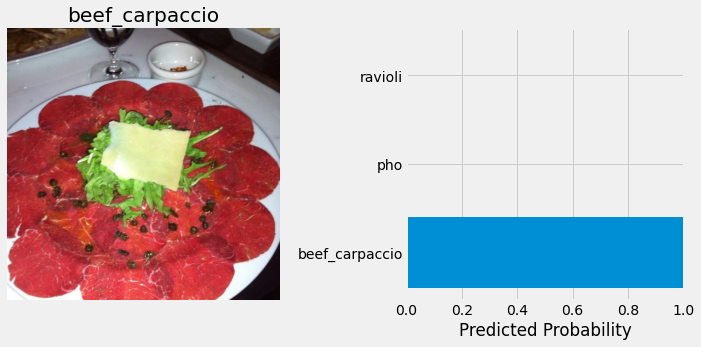

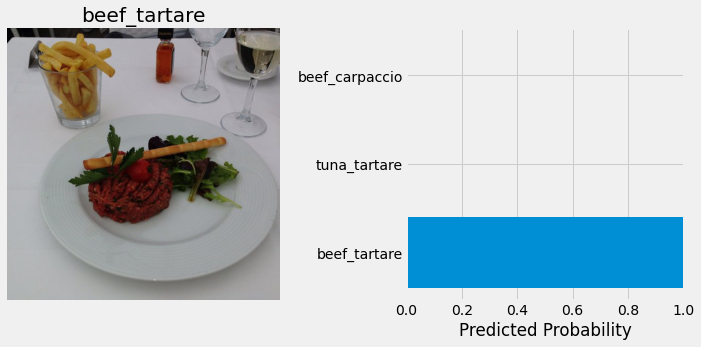

...

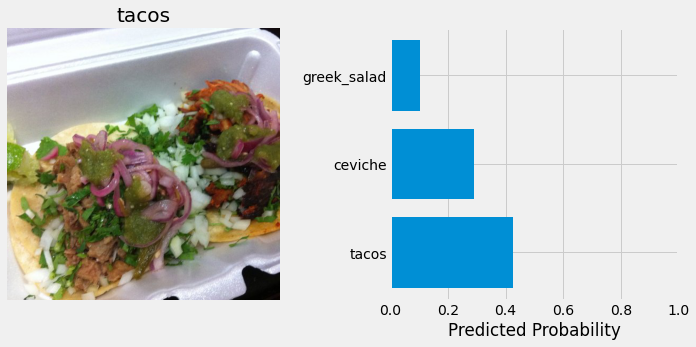

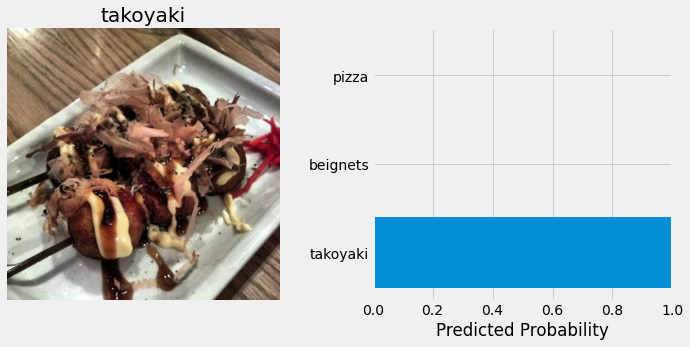

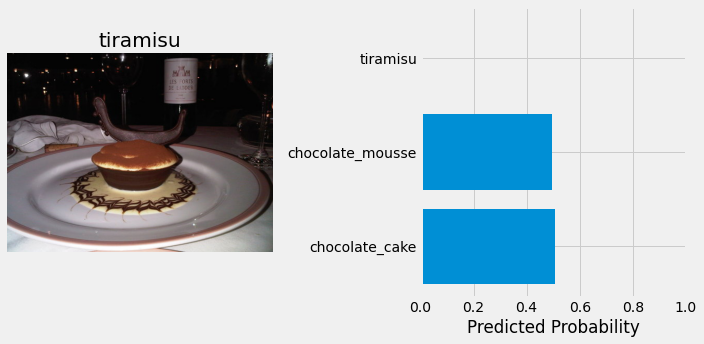

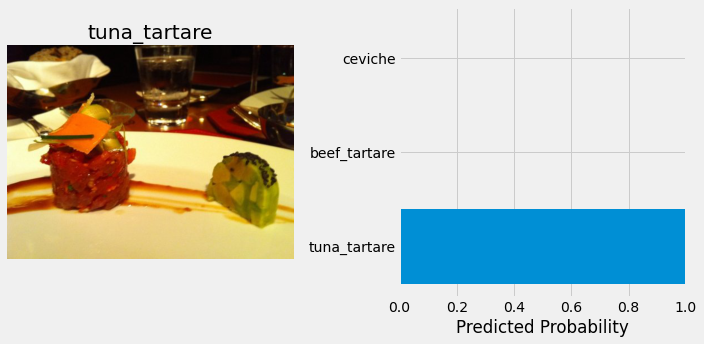

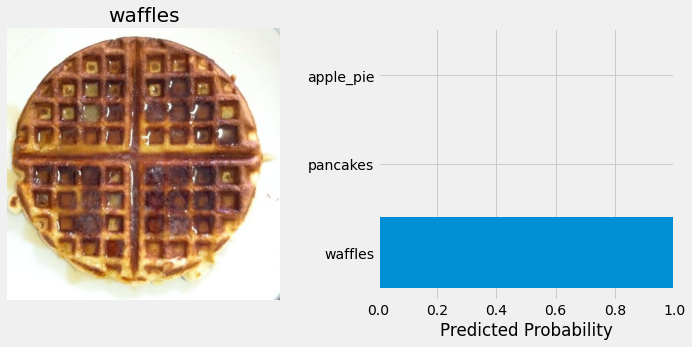

In [195]:
with open('food-101/meta/classes.txt', 'r') as txt:
    classes = [l.strip() for l in txt.readlines()]

for i in range(len(classes)):
    image_name = os.listdir(os.path.join('food-101/test', classes[i]))[100]
    image_path = os.path.join('food-101/test', classes[i], image_name)
    _,_,_ = display_image(model, image_path, train_on_gpu = True)



### THANK YOU